# Step 8: 2D Burgers Equation

This is a major milestone in our quest towards solving the Navier Stokes equations in 2D in python. The burger's equation is great to learn about CFD and fluid dynamics in general because it contains the full convective nonlinearity of the flow equations and at the same time has many known analytic solutions. An interesting thing about it is that it can generate discontinuous solutiosn from an initial condition that is smooth, in other words it can develop shocks. We wnat to see this occur in two dimensions. Let's start with our set of coupled PDEs:

$$ \frac{\partial u}{\partial t} + u \frac{\partial u}{\partial x} + v \frac{\partial u}{\partial y} = \nu  \left (\frac{\partial^2 u}{\partial x^2} + \frac{\partial^2 u}{\partial y^2}  \right ) $$

$$ \frac{\partial v}{\partial t} + u \frac{\partial v}{\partial x} + v \frac{\partial v}{\partial y} = \nu  \left (\frac{\partial^2 v}{\partial x^2} + \frac{\partial^2 v}{\partial y^2}  \right ) $$


## Discretization

We've built a pretty good amount of experience in discretizing these terms. Here are the results:

$$
 \frac{u_{i,j}^{n+1} - u_{i,j}^n}{\Delta t} + u_{i,j}^n \frac{u_{i,j}^n-u_{i-1,j}^n}{\Delta x} + v_{i,j}^n \frac{u_{i,j}^n - u_{i,j-1}^n}{\Delta y} = $$
  $$\qquad \nu \bigg( \frac{u_{i+1,j}^n - 2u_{i,j}^n+u_{i-1,j}^n}{\Delta x^2} + \frac{u_{i,j+1}^n - 2u_{i,j}^n + u_{i,j-1}^n}{\Delta y^2} \bigg)$$

$$
\frac{v_{i,j}^{n+1} - v_{i,j}^n}{\Delta t} + u_{i,j}^n \frac{v_{i,j}^n-v_{i-1,j}^n}{\Delta x} + v_{i,j}^n \frac{v_{i,j}^n - v_{i,j-1}^n}{\Delta y} = $$
$$\nu \bigg( \frac{v_{i+1,j}^n - 2v_{i,j}^n+v_{i-1,j}^n}{\Delta x^2} + \frac{v_{i,j+1}^n - 2v_{i,j}^n + v_{i,j-1}^n}{\Delta y^2} \bigg)$$

As always, we solve for our only unknown $u^{n+1}_{i,j}$ and $v^{n+1}_{i,j}$ and iterate through the equation that follows:

 $$u_{i,j}^{n+1} = u_{i,j}^n - \frac{\Delta t}{\Delta x} u_{i,j}^n (u_{i,j}^n - u_{i-1,j}^n) - \frac{\Delta t}{\Delta y} v_{i,j}^n (u_{i,j}^n - u_{i,j-1}^n)+ $$
 $$ \frac{\nu \Delta t}{\Delta x^2}(u_{i+1,j}^n-2u_{i,j}^n+u_{i-1,j}^n) + \frac{\nu \Delta t}{\Delta y^2} (u_{i,j+1}^n - 2u_{i,j}^n + u_{i,j+1}^n)$$ 

 $$v_{i,j}^{n+1} =  v_{i,j}^n - \frac{\Delta t}{\Delta x} u_{i,j}^n (v_{i,j}^n - v_{i-1,j}^n) - \frac{\Delta t}{\Delta y} v_{i,j}^n (v_{i,j}^n - v_{i,j-1}^n)+ $$
 $$ \frac{\nu \Delta t}{\Delta x^2}(v_{i+1,j}^n-2v_{i,j}^n+v_{i-1,j}^n) + \frac{\nu \Delta t}{\Delta y^2} (v_{i,j+1}^n - 2v_{i,j}^n + v_{i,j+1}^n)$$ 


## Initial and Boundary Conditions

We will solve the equation with the same initial conditions:

$$ u,v = \begin{cases}
\begin{matrix}
2 & \text{for } x,y \in (0.5,1) \times (0.5,1) \cr
1 & \text{everywhere else}
\end{matrix}\end{cases}
$$

And boundary conditions:

$$ u = 1, v=1 \ \text{for}  \begin{cases}
\begin{matrix}
 x = 0,2 \cr
 y = 0,2 
\end{matrix}
\end{cases}
$$

The boundary conditions set u and v equal to 1 along boundaries of the grid:

## Libraries and Variable declarations

### Lib import

In [1]:
# Adding inline command to make plots appear under comments
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from mpl_toolkits.mplot3d import Axes3D
%matplotlib notebook

### Variable Declarations

In [2]:
grid_length_x = 2
grid_length_y = 2
grid_points_x = 41
grid_points_y = 41
nt = 240
c = 1
nu = .01
dx = grid_length_x / (grid_points_x - 1) 
dy = grid_length_y / (grid_points_y - 1) 
sigma = .0009
dt = sigma * dx * dy / nu

x = np.linspace(0, grid_length_x, grid_points_x)
y = np.linspace(0, grid_length_y, grid_points_y)

u = np.ones((grid_points_x, grid_points_y))
v = np.ones((grid_points_x, grid_points_y))
un = np.ones((grid_points_x, grid_points_y))
vn = np.ones((grid_points_x, grid_points_y))

#Initiallizing the array containing the shape of our initial conditions
u[int(.5 / dy):int(1 / dy + 1),int(.5 / dx):int(1 / dx + 1)] = 2 
v[int(.5 / dy):int(1 / dy + 1),int(.5 / dx):int(1 / dx + 1)] = 2 

### Plotting initial conditions

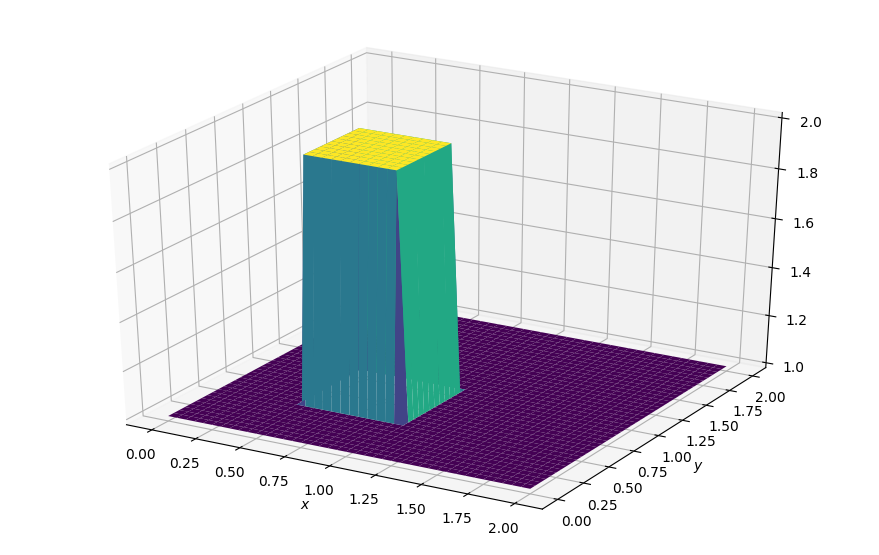

In [3]:
fig = plt.figure(figsize=(11,7), dpi= 100)
ax = fig.gca(projection='3d')
X,Y = np.meshgrid(x,y)

surf = ax.plot_surface(X,Y, u[:], cmap=cm.viridis, rstride=1, cstride=1)
ax.set_xlabel('$x$')
ax.set_ylabel('$y$');

## Solving in 2D

In [4]:
for n in range(nt): ##loop across number of time steps
    un = u.copy()
    vn = v.copy()

    u[1:-1, 1:-1] = (un[1:-1, 1:-1] -
                     dt / dx * un[1:-1, 1:-1] * 
                     (un[1:-1, 1:-1] - un[1:-1, 0:-2]) - 
                     dt / dy * vn[1:-1, 1:-1] * 
                     (un[1:-1, 1:-1] - un[0:-2, 1:-1]) + 
                     nu * dt / dx**2 * 
                     (un[1:-1,2:] - 2 * un[1:-1, 1:-1] + un[1:-1, 0:-2]) + 
                     nu * dt / dy**2 * 
                     (un[2:, 1:-1] - 2 * un[1:-1, 1:-1] + un[0:-2, 1:-1]))
    
    v[1:-1, 1:-1] = (vn[1:-1, 1:-1] - 
                     dt / dx * un[1:-1, 1:-1] *
                     (vn[1:-1, 1:-1] - vn[1:-1, 0:-2]) -
                     dt / dy * vn[1:-1, 1:-1] * 
                    (vn[1:-1, 1:-1] - vn[0:-2, 1:-1]) + 
                     nu * dt / dx**2 * 
                     (vn[1:-1, 2:] - 2 * vn[1:-1, 1:-1] + vn[1:-1, 0:-2]) +
                     nu * dt / dy**2 *
                     (vn[2:, 1:-1] - 2 * vn[1:-1, 1:-1] + vn[0:-2, 1:-1]))
     
    u[0, :] = 1
    u[-1, :] = 1
    u[:, 0] = 1
    u[:, -1] = 1
    
    v[0, :] = 1
    v[-1, :] = 1
    v[:, 0] = 1
    v[:, -1] = 1

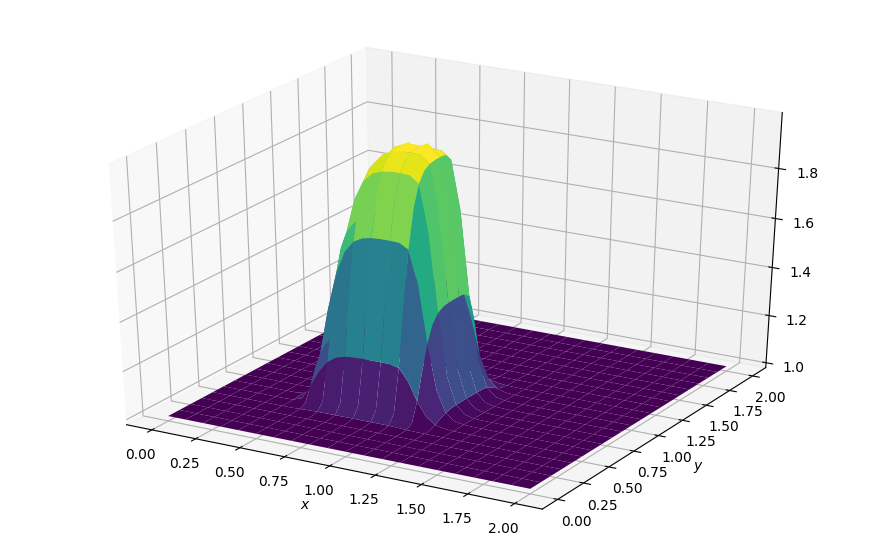

In [5]:
fig = plt.figure(figsize=(11,7), dpi= 100)
ax = fig.gca(projection='3d')
X,Y = np.meshgrid(x,y)

surf = ax.plot_surface(X,Y, u[:], cmap=cm.viridis, rstride=2, cstride=2)
ax.set_xlabel('$x$')
ax.set_ylabel('$y$');

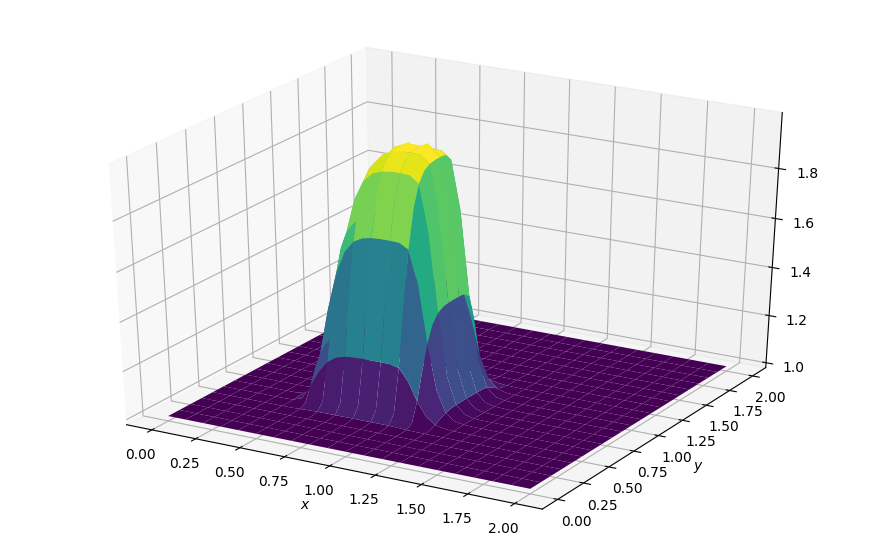

In [6]:
fig = plt.figure(figsize=(11,7), dpi= 100)
ax = fig.gca(projection='3d')
X,Y = np.meshgrid(x,y)

surf = ax.plot_surface(X,Y, v[:], cmap=cm.viridis, rstride=2, cstride=2)
ax.set_xlabel('$x$')
ax.set_ylabel('$y$');

### Results

As expected, this looks pretty similar to the combination of the convection and diffussion terms.

## Animating the simulation

/home/angel/.local/lib/python3.6/site-packages/ipykernel_launcher.py:15: UserWarning: Requested projection is different from current axis projection, creating new axis with requested projection.
  from ipykernel import kernelapp as app


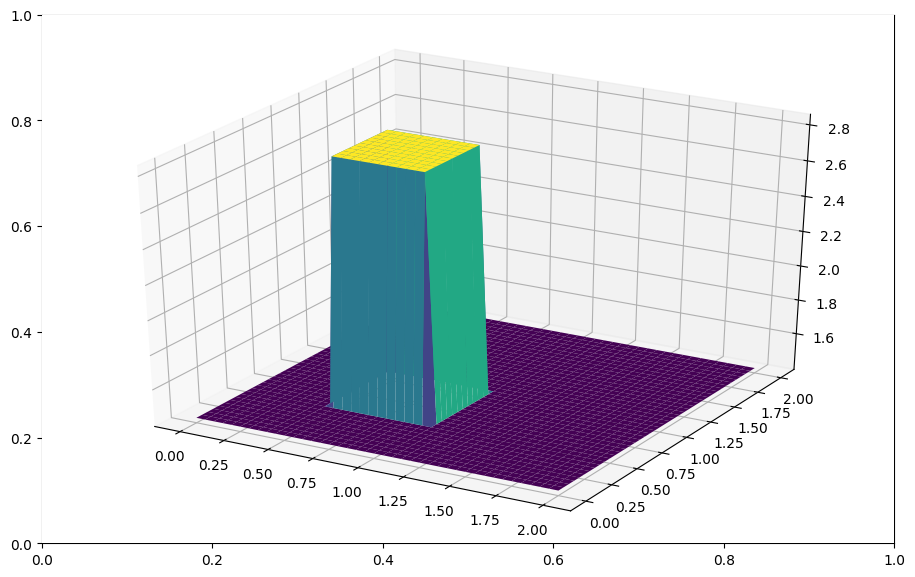

In [7]:
#Imports for animation and display within a jupyter notebook
from matplotlib import animation, rc 
from IPython.display import HTML

#Resetting the U wave back to initial conditions
u = np.ones((grid_points_x, grid_points_y))
u[int(.5 / dy):int(1 / dy + 1), int(.5 / dx):int(1 / dx + 1)] = 2

v = np.ones((grid_points_x, grid_points_y))
v[int(.5 / dy):int(1 / dy + 1), int(.5 / dx):int(1 / dx + 1)] = 2
#Generating the figure that will contain the animation
fig, ax = plt.subplots()
fig.set_dpi(100)
fig.set_size_inches(11,7)
ax = fig.gca(projection='3d')

surf = ax.plot_surface(X, Y, np.sqrt(u**2 + v**2) , cmap=cm.viridis)

In [8]:
#Initialization function for funcanimation
def init():
    ax.clear()
    surf = ax.plot_surface(X, Y, u , cmap=cm.viridis)
    return surf

In [9]:
#Main animation function, each frame represents a time step in our calculation
def animate(j):
    un = u.copy()
    vn = v.copy()

    u[1:-1, 1:-1] = (un[1:-1, 1:-1] -
                     dt / dx * un[1:-1, 1:-1] * 
                     (un[1:-1, 1:-1] - un[1:-1, 0:-2]) - 
                     dt / dy * vn[1:-1, 1:-1] * 
                     (un[1:-1, 1:-1] - un[0:-2, 1:-1]) + 
                     nu * dt / dx**2 * 
                     (un[1:-1,2:] - 2 * un[1:-1, 1:-1] + un[1:-1, 0:-2]) + 
                     nu * dt / dy**2 * 
                     (un[2:, 1:-1] - 2 * un[1:-1, 1:-1] + un[0:-2, 1:-1]))
    
    v[1:-1, 1:-1] = (vn[1:-1, 1:-1] - 
                     dt / dx * un[1:-1, 1:-1] *
                     (vn[1:-1, 1:-1] - vn[1:-1, 0:-2]) -
                     dt / dy * vn[1:-1, 1:-1] * 
                    (vn[1:-1, 1:-1] - vn[0:-2, 1:-1]) + 
                     nu * dt / dx**2 * 
                     (vn[1:-1, 2:] - 2 * vn[1:-1, 1:-1] + vn[1:-1, 0:-2]) +
                     nu * dt / dy**2 *
                     (vn[2:, 1:-1] - 2 * vn[1:-1, 1:-1] + vn[0:-2, 1:-1]))
     
    u[0, :] = 1
    u[-1, :] = 1
    u[:, 0] = 1
    u[:, -1] = 1
    
    v[0, :] = 1
    v[-1, :] = 1
    v[:, 0] = 1
    v[:, -1] = 1
    
    ax.clear()
    surf = ax.plot_surface(X, Y,u,rstride=1, cstride=1, cmap=cm.viridis, linewidth= 0, antialiased=True)
    ax.set_zlim(1, 2.5)
    ax.set_xlabel('$x$')
    ax.set_ylabel('$y$');
    return surf

In [10]:
anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=nt, interval=20)
HTML(anim.to_jshtml())

Animation size has reached 21124281 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


## Conclusion

Next we move take a small detour to talk about how to define functiosn in python.